# Taming Transformers
## Reconstruction Capabilities of VQGAN (Colab Notebook)

This notebook provides code to (visually) analyze the first stage models used to generate images as in [Taming Transformers for High-Resolution Image Synthesis](https://github.com/CompVis/taming-transformers)
and a comparison to the first stage model used in [DALL-E](https://openai.com/blog/dall-e/).

### Setup
Clone the repository and download pretrained VQGANs: a small one with a codebook dimensionality $\dim \mathcal{Z} = 1024$
and a larger one with $ \dim \mathcal{Z} = 16384$. Both perform *four* downsampling steps, e.g. an input image of
size $256 \times 256$ will be mapped to a latent code of size $16 \times 16$.
Additionally, also load a model which only uses three downsampling steps, such that the latent code will have size $32 \times 32$. The increased capacity of the representation helps to produce higher quality reconstructions, but this makes training a transformer model with full attention much more expensive.

In [1]:
!git clone https://github.com/CompVis/taming-transformers
%cd taming-transformers

fatal: destination path 'taming-transformers' already exists and is not an empty directory.
/Users/thachha/Desktop/AIO2025-official/AIMA/CP- WSSS/taming-transformers/scripts/taming-transformers


In [2]:
%cd taming-transformers

[Errno 2] No such file or directory: 'taming-transformers'
/Users/thachha/Desktop/AIO2025-official/AIMA/CP- WSSS/taming-transformers/scripts/taming-transformers


In [3]:
# download a VQGAN with f=16 (16x compression per spatial dimension) and with a codebook with 1024 entries
!mkdir -p logs/vqgan_imagenet_f16_1024/checkpoints
!mkdir -p logs/vqgan_imagenet_f16_1024/configs
!wget 'https://heibox.uni-heidelberg.de/f/140747ba53464f49b476/?dl=1' -O 'logs/vqgan_imagenet_f16_1024/checkpoints/last.ckpt' 
!wget 'https://heibox.uni-heidelberg.de/f/6ecf2af6c658432c8298/?dl=1' -O 'logs/vqgan_imagenet_f16_1024/configs/model.yaml' 

# download a VQGAN with f=16 (16x compression per spatial dimension) and with a larger codebook (16384 entries)
!mkdir -p logs/vqgan_imagenet_f16_16384/checkpoints
!mkdir -p logs/vqgan_imagenet_f16_16384/configs
!wget 'https://heibox.uni-heidelberg.de/f/867b05fc8c4841768640/?dl=1' -O 'logs/vqgan_imagenet_f16_16384/checkpoints/last.ckpt' 
!wget 'https://heibox.uni-heidelberg.de/f/274fb24ed38341bfa753/?dl=1' -O 'logs/vqgan_imagenet_f16_16384/configs/model.yaml' 

# download a VQGAN with f=8 (8x compression per spatial dimension) and a larger codebook-size with 8192 entries
!mkdir -p logs/vqgan_gumbel_f8/checkpoints
!mkdir -p logs/vqgan_gumbel_f8/configs
!wget 'https://heibox.uni-heidelberg.de/f/34a747d5765840b5a99d/?dl=1' -O 'logs/vqgan_gumbel_f8/checkpoints/last.ckpt' 
!wget 'https://heibox.uni-heidelberg.de/f/b24d14998a8d4f19a34f/?dl=1' -O 'logs/vqgan_gumbel_f8/configs/model.yaml' 

--2025-11-04 14:38:23--  https://heibox.uni-heidelberg.de/f/140747ba53464f49b476/?dl=1
Resolving heibox.uni-heidelberg.de (heibox.uni-heidelberg.de)... 129.206.7.113
Connecting to heibox.uni-heidelberg.de (heibox.uni-heidelberg.de)|129.206.7.113|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://heibox.uni-heidelberg.de/seafhttp/files/8251a7b2-7adf-48b3-81ac-5bba5719845b/last.ckpt [following]
--2025-11-04 14:38:25--  https://heibox.uni-heidelberg.de/seafhttp/files/8251a7b2-7adf-48b3-81ac-5bba5719845b/last.ckpt
Reusing existing connection to heibox.uni-heidelberg.de:443.
HTTP request sent, awaiting response... 200 OK
Length: 957954257 (914M) [application/octet-stream]
Saving to: ‘logs/vqgan_imagenet_f16_1024/checkpoints/last.ckpt’

logs/vqgan_imagenet 100%[===================>] 913.58M  2.72MB/s    in 5m 25s  

2025-11-04 14:43:50 (2.81 MB/s) - ‘logs/vqgan_imagenet_f16_1024/checkpoints/last.ckpt’ saved [957954257/957954257]

--2025-11-04 14:43:51--  h

Install minimal required dependencies.

In [23]:
%%capture
!pip install omegaconf>=2.0.0 pytorch-lightning>=1.0.8 einops>=0.3.0
import sys
sys.path.append(".")

# also disable grad to save memory
import torch
torch.set_grad_enabled(False)

DEVICE = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

Define some loading utilities

In [98]:
import torch
import yaml
from omegaconf import OmegaConf 
from taming.models.vqgan import VQModel, GumbelVQ

def load_vqgan_2(config, ckpt_path=None, is_gumbel=False):
    # 1) Khởi tạo model
    model = GumbelVQ(**config.model.params) if is_gumbel else VQModel(**config.model.params)

    if ckpt_path is None:
        return model.eval()

    # 2) Tải checkpoint
    ckpt = torch.load(ckpt_path, map_location="cpu", weights_only=False)

    # 3) Lấy state_dict theo các trường hợp phổ biến
    if isinstance(ckpt, dict):
        if "state_dict" in ckpt and isinstance(ckpt["state_dict"], dict):
            sd = ckpt["state_dict"]
        elif "model" in ckpt and isinstance(ckpt["model"], dict):
            sd = ckpt["model"]
        elif "state_dict_ema" in ckpt and isinstance(ckpt["state_dict_ema"], dict):
            sd = ckpt["state_dict_ema"]
        elif "ema" in ckpt and isinstance(ckpt["ema"], dict):
            sd = ckpt["ema"]
        else:
            # giả định raw state_dict nếu value là Tensor
            if all(isinstance(v, torch.Tensor) for v in ckpt.values()):
                sd = ckpt
            else:
                raise ValueError(f"Không tìm thấy state_dict phù hợp trong checkpoint. Keys: {list(ckpt.keys())[:10]}")
    else:
        # e.g., OrderedDict trực tiếp
        sd = ckpt

    # 4) Load (lenient)
    missing, unexpected = model.load_state_dict(sd, strict=False)
    if missing or unexpected:
        print(f"[VQGAN] Missing: {len(missing)}, Unexpected: {len(unexpected)}")

    return model.eval()


In [5]:
import yaml
import torch
from omegaconf import OmegaConf 
from taming.models.vqgan import VQModel, GumbelVQ

def load_config(config_path, display=False):
  config = OmegaConf.load(config_path)
  if display:
    print(yaml.dump(OmegaConf.to_container(config))) #.dump to print the config format nicely if display=True
  return config

def load_vqgan(config, ckpt_path=None, is_gumbel=False): # load a VQGAN model from a config and checkpoint
  if is_gumbel: # use GumbelVQ 
    model = GumbelVQ(**config.model.params)
  else: # use VQModel 
    model = VQModel(**config.model.params)
  if ckpt_path is not None:
    sd = torch.load(ckpt_path, map_location="cpu", weights_only=False)["state_dict"]
    missing, unexpected = model.load_state_dict(sd, strict=False)
  return model.eval()

def preprocess_vqgan(x): # convert from range [0, 1] to [-1, 1] to use tanh() in output decoder
  x = 2.*x - 1.
  return x

def custom_to_pil(x): # convert a tensor to a PIL Image
  x = x.detach().cpu() # .detach to create a tensor that shares the same dataa as the original one but does not require gradients
  x = torch.clamp(x, -1., 1.) # .clamp to limit the values to a given range 
  x = (x + 1.)/2. # scale to [0, 1]
  x = x.permute(1,2,0).numpy() # convert to HWC
  x = (255*x).astype(np.uint8) # scale to [0, 255]
  x = Image.fromarray(x) # convert to PIL Image
  if not x.mode == "RGB": # ensure 3 channels
    x = x.convert("RGB")
  return x

def reconstruct_with_vqgan(x, model):
  # could also use model(x) for reconstruction but use explicit encoding and decoding here
  z, _, [_, _, indices] = model.encode(x)
  print(f"VQGAN --- {model.__class__.__name__}: latent shape: {z.shape[2:]}")
  xrec = model.decode(z)
  return xrec

/Users/thachha/anaconda3/anaconda3/envs/taming/lib/python3.10/site-packages/torchmetrics/utilities/imports.py:21: UserWarning: pkg_resources is deprecated as an API. See https://setuptools.pypa.io/en/latest/pkg_resources.html. The pkg_resources package is slated for removal as early as 2025-11-30. Refrain from using this package or pin to Setuptools<81.
  from pkg_resources import DistributionNotFound, get_distribution


## Load the VQGANs

First, load (and optionally display) the model configs. Then, load the VQGAN models.
Start with the f=16 models.

In [8]:
config1024 = load_config("logs/vqgan_imagenet_f16_1024/configs/model.yaml", display=False)
config16384 = load_config("logs/vqgan_imagenet_f16_16384/configs/model.yaml", display=False)

model1024 = load_vqgan(config1024, ckpt_path="logs/vqgan_imagenet_f16_1024/checkpoints/last.ckpt").to(DEVICE)
model16384 = load_vqgan(config16384, ckpt_path="logs/vqgan_imagenet_f16_16384/checkpoints/last.ckpt").to(DEVICE)

Working with z of shape (1, 256, 16, 16) = 65536 dimensions.


/Users/thachha/anaconda3/anaconda3/envs/taming/lib/python3.10/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/Users/thachha/anaconda3/anaconda3/envs/taming/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


loaded pretrained LPIPS loss from taming/modules/autoencoder/lpips/vgg.pth
VQLPIPSWithDiscriminator running with hinge loss.
Working with z of shape (1, 256, 16, 16) = 65536 dimensions.
loaded pretrained LPIPS loss from taming/modules/autoencoder/lpips/vgg.pth
VQLPIPSWithDiscriminator running with hinge loss.


Also load a f8 model. This model trades compressive power for higher reconstruction fidelity.
For example, an input image of size $256 \times 256$ will be encoded to a representation of size $32\times 32$. Due to the 
quadratic complexity of the attention mechanism, this makes downstream
autogressive training of a full-attention transformer model much more expensive (by a factor 16), as the unrolled sequence now
has a length of $32\cdot 32 = 1024$ (compare this to a f16-VQGAN which gives a representation of size $16\cdot 16 = 256$).

In [100]:
config_bcss = load_config("/Users/thachha/Desktop/AIO2025-official/AIMA/CP- WSSS/taming-transformers/configs/bcss_wsss_vqgan_modified_main.yaml", display=False)
model_bcss = load_vqgan_2(config_bcss, ckpt_path="/Users/thachha/Desktop/AIO2025-official/AIMA/CP- WSSS/vqgan-wsss/checkpoints/last_checkpoint.pth", is_gumbel=False).to(DEVICE)

Working with z of shape (1, 256, 32, 32) = 262144 dimensions.
loaded pretrained LPIPS loss from taming/modules/autoencoder/lpips/vgg.pth
VQLPIPSWithDiscriminator running with hinge loss.


In [101]:
config32x32 = load_config("logs/vqgan_gumbel_f8/configs/model.yaml", display=False)
model32x32 = load_vqgan(config32x32, ckpt_path="logs/vqgan_gumbel_f8/checkpoints/last.ckpt", is_gumbel=True).to(DEVICE)

Working with z of shape (1, 256, 32, 32) = 262144 dimensions.


## DALL-E joins the party
Code reproduced from the official notebook available at https://github.com/openai/DALL-E/blob/master/notebooks/usage.ipynb

In [10]:
%pip install git+https://github.com/openai/DALL-E.git &> /dev/null

Note: you may need to restart the kernel to use updated packages.


In [108]:
import io
import os, sys
import requests
import PIL
from PIL import Image
from PIL import ImageDraw, ImageFont
import numpy as np

import torch
import torch.nn.functional as F
import torchvision.transforms as T
import torchvision.transforms.functional as TF

from dall_e          import map_pixels, unmap_pixels, load_model
from IPython.display import display, display_markdown

try:
    font = ImageFont.truetype("/usr/share/fonts/truetype/liberation/LiberationSans-BoldItalic.ttf", 22)
except OSError:
    font = ImageFont.load_default()
    
def download_image(url):
    resp = requests.get(url)
    resp.raise_for_status()
    return PIL.Image.open(io.BytesIO(resp.content))


def preprocess(img, target_image_size=256, map_dalle=True):
    s = min(img.size)
    
    #if s < target_image_size:
     #   raise ValueError(f'min dim for image {s} < {target_image_size}')
        
    r = target_image_size / s
    s = (round(r * img.size[1]), round(r * img.size[0]))
    img = TF.resize(img, s, interpolation=PIL.Image.LANCZOS)
    img = TF.center_crop(img, output_size=2 * [target_image_size])
    img = torch.unsqueeze(T.ToTensor()(img), 0)
    if map_dalle: 
      img = map_pixels(img)
    return img


def reconstruct_with_dalle(x, encoder, decoder, do_preprocess=False):
  # takes in tensor (or optionally, a PIL image) and returns a PIL image
  if do_preprocess:
    x = preprocess(x)
  z_logits = encoder(x)
  z = torch.argmax(z_logits, axis=1)
  
  print(f"DALL-E: latent shape: {z.shape}")
  z = F.one_hot(z, num_classes=encoder.vocab_size).permute(0, 3, 1, 2).float()

  x_stats = decoder(z).float()
  x_rec = unmap_pixels(torch.sigmoid(x_stats[:, :3]))
  x_rec = T.ToPILImage(mode='RGB')(x_rec[0])

  return x_rec


def stack_reconstructions(input, x0, x1, x2, x3, titles=[]):
  assert input.size == x1.size == x2.size == x3.size
  print(x0.size)
  print(x1.size)
  print(x1.size)
  print(x3.size)
  w, h = input.size[0], input.size[1]
  img = Image.new("RGB", (5*w, h))
  img.paste(input, (0,0))
  img.paste(x0, (1*w,0))
  img.paste(x1, (2*w,0))
  img.paste(x2, (3*w,0))
  img.paste(x3, (4*w,0))
  for i, title in enumerate(titles):
    ImageDraw.Draw(img).text((i*w, 0), f'{title}', (255, 255, 255), font=font) # coordinates, text, color, font
  return img

Load the provided encoder and decoder.

In [12]:
import inspect
print(inspect.getsource(load_model))

def load_model(path: str, device: torch.device = None, weights_only=False) -> nn.Module:
    if path.startswith('http://') or path.startswith('https://'):
        resp = requests.get(path)
        resp.raise_for_status()
            
        with io.BytesIO(resp.content) as buf:
            return torch.load(buf, map_location=device, weights_only = weights_only)
    else:
        with open(path, 'rb') as f:
            return torch.load(f, map_location=device, weights_only = weights_only)



In [13]:
!wget https://cdn.openai.com/dall-e/encoder.pkl -O encoder.pkl
!wget https://cdn.openai.com/dall-e/decoder.pkl -O decoder.pkl

--2025-11-04 15:08:32--  https://cdn.openai.com/dall-e/encoder.pkl
Resolving cdn.openai.com (cdn.openai.com)... 13.107.213.31, 13.107.246.31
Connecting to cdn.openai.com (cdn.openai.com)|13.107.213.31|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 215185363 (205M) [application/octet-stream]
Saving to: ‘encoder.pkl’

encoder.pkl         100%[===================>] 205.22M  3.01MB/s    in 1m 40s  

2025-11-04 15:10:14 (2.06 MB/s) - ‘encoder.pkl’ saved [215185363/215185363]

--2025-11-04 15:10:14--  https://cdn.openai.com/dall-e/decoder.pkl
Resolving cdn.openai.com (cdn.openai.com)... 13.107.246.31, 13.107.213.31
Connecting to cdn.openai.com (cdn.openai.com)|13.107.246.31|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 175360231 (167M) [application/octet-stream]
Saving to: ‘decoder.pkl’

decoder.pkl         100%[===================>] 167.24M  3.13MB/s    in 73s     

2025-11-04 15:11:29 (2.29 MB/s) - ‘decoder.pkl’ saved [175360231/175360

In [14]:
encoder_dalle = load_model("encoder.pkl", DEVICE, weights_only=False)  # load_model should call torch.load(..., weights_only=False)
decoder_dalle = load_model("decoder.pkl", DEVICE, weights_only=False)

## Reconstruct some images

Define the reconstruction pipeline and stack the reconstructions for a direct comparison.

In [35]:
titles=["Input", "DALL-E dVAE (f8, 8192)", "VQGAN (f8, 8192)", "VQGAN (f16, 16384)", "VQGAN (f16, 1024)"]
def reconstruction_pipeline(url, size=320):
  x_dalle = preprocess(download_image(url), target_image_size=size, map_dalle=True)
  x_vqgan = preprocess(download_image(url), target_image_size=size, map_dalle=False)
  x_dalle = x_dalle.to(DEVICE)
  x_vqgan = x_vqgan.to(DEVICE)
  
  print(f"input is of size: {x_vqgan.shape}")
  x0 = reconstruct_with_vqgan(preprocess_vqgan(x_vqgan), model32x32)
  x1 = reconstruct_with_vqgan(preprocess_vqgan(x_vqgan), model16384)
  x2 = reconstruct_with_vqgan(preprocess_vqgan(x_vqgan), model1024)
  x3 = reconstruct_with_dalle(x_dalle, encoder_dalle, decoder_dalle)
  img = stack_reconstructions(custom_to_pil(preprocess_vqgan(x_vqgan[0])), x3, 
                              custom_to_pil(x0[0]), custom_to_pil(x1[0]), 
                              custom_to_pil(x2[0]), titles=titles)
  return img

In [103]:

titles=["Input", "VQGAN (f8, 8192)", "VQGAN (f16, 16384)", "VQGAN (f16, 1024)","BCSS-retrain (f8, 1024)"]
def reconstruction_pipeline(url, size=384):
  x_vqgan = preprocess(download_image(url), target_image_size=size, map_dalle=False)
  x_vqgan = x_vqgan.to(DEVICE)
  
  print(f"input is of size: {x_vqgan.shape}")
  x0 = reconstruct_with_vqgan(preprocess_vqgan(x_vqgan), model32x32)
  x1 = reconstruct_with_vqgan(preprocess_vqgan(x_vqgan), model16384)
  x2 = reconstruct_with_vqgan(preprocess_vqgan(x_vqgan), model1024)
  x3 = reconstruct_with_vqgan(preprocess_vqgan(x_vqgan), model_bcss)
  img = stack_reconstructions(custom_to_pil(preprocess_vqgan(x_vqgan[0])), 
                              custom_to_pil(x0[0]), custom_to_pil(x1[0]), 
                              custom_to_pil(x2[0]),  custom_to_pil(x3[0]), titles=titles)
  return img

In [71]:

url='https://heibox.uni-heidelberg.de/f/7bb608381aae4539ba7a/?dl=1'
x_vqgan = preprocess(download_image(url), target_image_size=384, map_dalle=False)
x_vqgan = x_vqgan.to(DEVICE)
x3 = reconstruct_with_vqgan(preprocess_vqgan(x_vqgan), model32x32)


VQGAN --- GumbelVQ: latent shape: torch.Size([48, 48])


In [68]:
url='https://heibox.uni-heidelberg.de/f/7bb608381aae4539ba7a/?dl=1'
x_vqgan = preprocess(download_image(url), target_image_size=384, map_dalle=False)
x_vqgan = x_vqgan.to(DEVICE)
x3 = reconstruct_with_vqgan(preprocess_vqgan(x_vqgan), model_bcss)


VQGAN --- GumbelVQ: latent shape: torch.Size([48, 48])


In [70]:
print(x3)
print(type(x3))
print(x3.size())

tensor([[[[ 0.3060,  0.2769,  0.2694,  ..., -0.2038, -0.2210, -0.1661],
          [ 0.2826,  0.2516,  0.2682,  ..., -0.2212, -0.2246, -0.1978],
          [ 0.2816,  0.2735,  0.2778,  ..., -0.2327, -0.2331, -0.2162],
          ...,
          [ 0.4095,  0.4904,  0.0739,  ...,  0.3961,  0.3999,  0.3003],
          [ 0.4206,  0.5802,  0.4966,  ...,  0.2992,  0.3455,  0.3899],
          [ 0.4188,  0.5357,  0.6967,  ...,  0.2259,  0.2484,  0.3752]],

         [[ 0.3694,  0.3661,  0.3649,  ..., -0.1867, -0.1825, -0.1521],
          [ 0.4081,  0.3805,  0.3418,  ..., -0.2125, -0.1965, -0.1818],
          [ 0.4013,  0.3702,  0.3583,  ..., -0.2311, -0.2291, -0.2014],
          ...,
          [ 0.3829,  0.4923,  0.0471,  ...,  0.3497,  0.3407,  0.2386],
          [ 0.4492,  0.6077,  0.4995,  ...,  0.3255,  0.3465,  0.3159],
          [ 0.4388,  0.5851,  0.7266,  ...,  0.2092,  0.2050,  0.2972]],

         [[-0.1591, -0.2041, -0.1910,  ..., -0.4651, -0.4886, -0.4606],
          [-0.1922, -0.1902, -

In [73]:
print(x3)
print(type(x3))
print(x3.size())

tensor([[[[ 0.2926,  0.2667,  0.2662,  ..., -0.2458, -0.2749, -0.2404],
          [ 0.2700,  0.2554,  0.2766,  ..., -0.2820, -0.2895, -0.2528],
          [ 0.2685,  0.2690,  0.2727,  ..., -0.2868, -0.2739, -0.2686],
          ...,
          [ 0.3882,  0.3336,  0.1174,  ...,  0.4551,  0.4305,  0.3703],
          [ 0.2866,  0.2553, -0.0119,  ...,  0.4786,  0.4570,  0.4724],
          [ 0.4597,  0.0810, -0.1223,  ...,  0.4143,  0.4202,  0.5284]],

         [[ 0.3527,  0.3634,  0.3678,  ..., -0.2460, -0.2553, -0.2416],
          [ 0.3970,  0.3895,  0.3530,  ..., -0.2861, -0.2736, -0.2489],
          [ 0.4030,  0.3724,  0.3620,  ..., -0.2945, -0.2813, -0.2642],
          ...,
          [ 0.3688,  0.3094,  0.0758,  ...,  0.4458,  0.4154,  0.3332],
          [ 0.2893,  0.2508, -0.0582,  ...,  0.4893,  0.4705,  0.4280],
          [ 0.4755,  0.1075, -0.1796,  ...,  0.4062,  0.3950,  0.4880]],

         [[-0.2110, -0.2451, -0.2325,  ..., -0.4730, -0.5051, -0.4986],
          [-0.2534, -0.2231, -

In [64]:
print(x3.size)

<built-in method size of Tensor object at 0x36daea9d0>


In [74]:
image = custom_to_pil(x3[0])
print(image)
image.show()


<PIL.Image.Image image mode=RGB size=384x384 at 0x31FE8FEB0>


In [109]:
titles = [
    "Input",
    "VQGAN (f8, 8192)",
    "VQGAN (f16, 16384)",
    "VQGAN (f16, 1024)",
    "BCSS-retrain (f8, 1024)"
]

def reconstruction_pipeline_from_path(image_path, size=384):
    # Load local image
    img = Image.open(image_path).convert("RGB")
    
    # Preprocess to VQGAN style tensor
    x_vqgan = preprocess(img, target_image_size=size, map_dalle=False)
    x_vqgan = x_vqgan.to(DEVICE)

    print(f"✅ Input image loaded: {image_path}")
    print(f"📐 Tensor shape: {x_vqgan.shape}")

    # Reconstructions
    x0 = reconstruct_with_vqgan(preprocess_vqgan(x_vqgan), model32x32)     # f8, 8192
    x1 = reconstruct_with_vqgan(preprocess_vqgan(x_vqgan), model16384)     # f16, 16384
    x2 = reconstruct_with_vqgan(preprocess_vqgan(x_vqgan), model1024)      # f16, 1024
    x3 = reconstruct_with_vqgan(preprocess_vqgan(x_vqgan), model_bcss)     # f8, 1024 (your retrain)

    # Convert outputs to PIL
    img = stack_reconstructions(
        custom_to_pil(preprocess_vqgan(x_vqgan[0])),
        custom_to_pil(x0[0]),
        custom_to_pil(x1[0]),
        custom_to_pil(x2[0]),
        custom_to_pil(x3[0]),
        titles=titles
    )

    return img


Let's reconstruct some images from the [DIV2K](https://data.vision.ee.ethz.ch/cvl/DIV2K/) dataset.

✅ Input image loaded: /Users/thachha/Desktop/AIO2025-official/AIMA/CP- WSSS/vqgan-wsss/data/sub_BCSS_WSSS/test/img/TCGA-D8-A27F-DX1_xmin98787_ymin6725_MPP-0.2500+0.png
📐 Tensor shape: torch.Size([1, 3, 384, 384])
VQGAN --- GumbelVQ: latent shape: torch.Size([48, 48])
VQGAN --- VQModel: latent shape: torch.Size([24, 24])
VQGAN --- VQModel: latent shape: torch.Size([24, 24])
VQGAN --- VQModel: latent shape: torch.Size([48, 48])
(384, 384)
(384, 384)
(384, 384)
(384, 384)


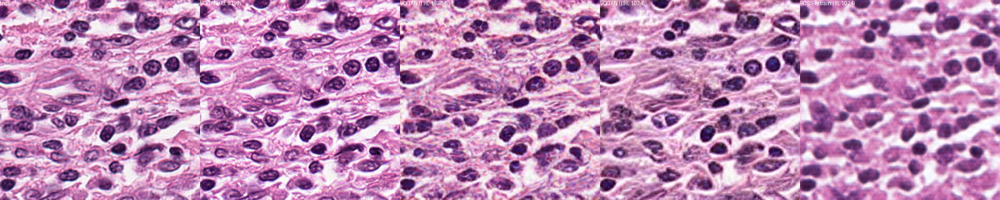

In [112]:
image_path = "/Users/thachha/Desktop/AIO2025-official/AIMA/CP- WSSS/vqgan-wsss/data/sub_BCSS_WSSS/test/img/TCGA-D8-A27F-DX1_xmin98787_ymin6725_MPP-0.2500+0.png"
reconstruction_pipeline_from_path(image_path, size=384)


input is of size: torch.Size([1, 3, 384, 384])
VQGAN --- GumbelVQ: latent shape: torch.Size([48, 48])
VQGAN --- VQModel: latent shape: torch.Size([24, 24])
VQGAN --- VQModel: latent shape: torch.Size([24, 24])
VQGAN --- VQModel: latent shape: torch.Size([48, 48])
(384, 384)
(384, 384)
(384, 384)
(384, 384)


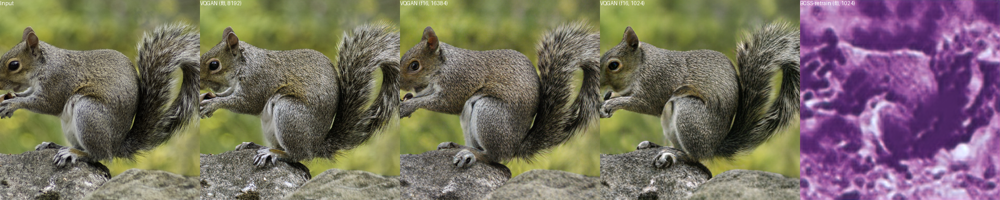

In [104]:
reconstruction_pipeline(url='https://heibox.uni-heidelberg.de/f/7bb608381aae4539ba7a/?dl=1', size=384)

Especially at regions like the squirrel's fur and tail, the VQGANs produce plausible textures whereas the first stage of DALL-E produces overly smooth regions despite using four times more codes. On the other hand, using fewer codes means that the VQGAN cannot reproduce every detail of its input but instead hallucinates parts of it. In particular, the VQGAN (1024) has difficulties reconstructing the foot, which can be remedied to some degree by the bigger codebook size of VQGAN (16384).

input is of size: torch.Size([1, 3, 384, 384])
VQGAN --- GumbelVQ: latent shape: torch.Size([48, 48])
VQGAN --- VQModel: latent shape: torch.Size([24, 24])
VQGAN --- VQModel: latent shape: torch.Size([24, 24])
VQGAN --- VQModel: latent shape: torch.Size([48, 48])
(384, 384)
(384, 384)
(384, 384)
(384, 384)


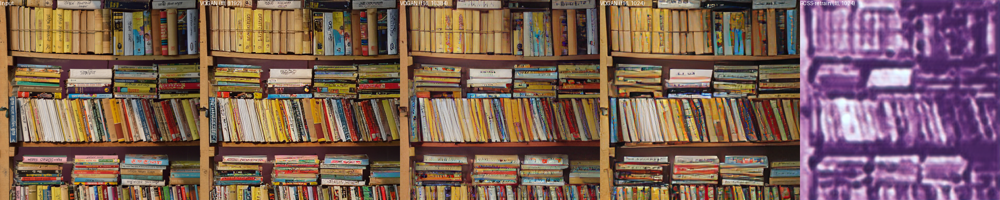

In [105]:
reconstruction_pipeline(url='https://heibox.uni-heidelberg.de/f/6f12b330eb564d288d76/?dl=1', size=384)

input is of size: torch.Size([1, 3, 384, 384])
VQGAN --- GumbelVQ: latent shape: torch.Size([48, 48])
VQGAN --- VQModel: latent shape: torch.Size([24, 24])
VQGAN --- VQModel: latent shape: torch.Size([24, 24])
VQGAN --- VQModel: latent shape: torch.Size([48, 48])
(384, 384)
(384, 384)
(384, 384)
(384, 384)


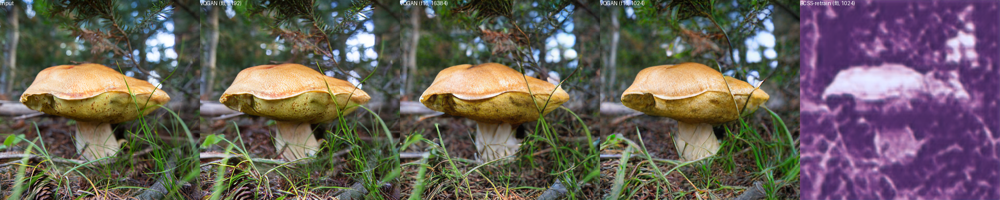

In [113]:
reconstruction_pipeline(url='https://heibox.uni-heidelberg.de/f/8555a959b0a5423cbfd1/?dl=1', size=384)

input is of size: torch.Size([1, 3, 384, 384])
VQGAN --- GumbelVQ: latent shape: torch.Size([48, 48])
VQGAN --- VQModel: latent shape: torch.Size([24, 24])
VQGAN --- VQModel: latent shape: torch.Size([24, 24])
VQGAN --- VQModel: latent shape: torch.Size([48, 48])
(384, 384)
(384, 384)
(384, 384)
(384, 384)


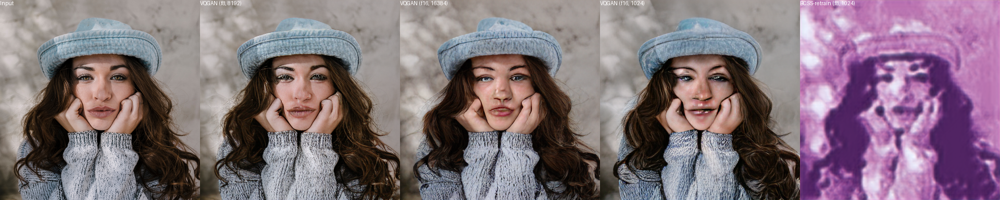

In [114]:
reconstruction_pipeline(url='https://heibox.uni-heidelberg.de/f/be6f4ff34e1544109563/?dl=1', size=384)

Faces are particularly difficult for the VQGAN to get right and the reconstructions of DALL-E's first stage appear more presentable. However, it should also be noted that the latter has been trained on a dataset which is roughly 400 times larger than the dataset (ImageNet) that the VQGAN was trained on. Thus, training the VQGAN on a larger dataset, or fine-tuning it on a dataset containing more faces, could improve the perceptual quality of reconstructed faces (and VQGANs trained on face datasets only do not show this problem).

input is of size: torch.Size([1, 3, 384, 384])
VQGAN --- GumbelVQ: latent shape: torch.Size([48, 48])
VQGAN --- VQModel: latent shape: torch.Size([24, 24])
VQGAN --- VQModel: latent shape: torch.Size([24, 24])
VQGAN --- VQModel: latent shape: torch.Size([48, 48])
(384, 384)
(384, 384)
(384, 384)
(384, 384)


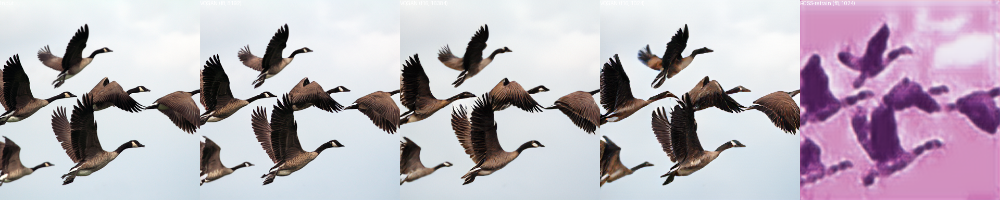

In [115]:
reconstruction_pipeline("https://heibox.uni-heidelberg.de/f/e41f5053cbd34f11a8d5/?dl=1", size=384)

And finally, the penguin.

input is of size: torch.Size([1, 3, 384, 384])
VQGAN --- GumbelVQ: latent shape: torch.Size([48, 48])
VQGAN --- VQModel: latent shape: torch.Size([24, 24])
VQGAN --- VQModel: latent shape: torch.Size([24, 24])
VQGAN --- VQModel: latent shape: torch.Size([48, 48])
(384, 384)
(384, 384)
(384, 384)
(384, 384)


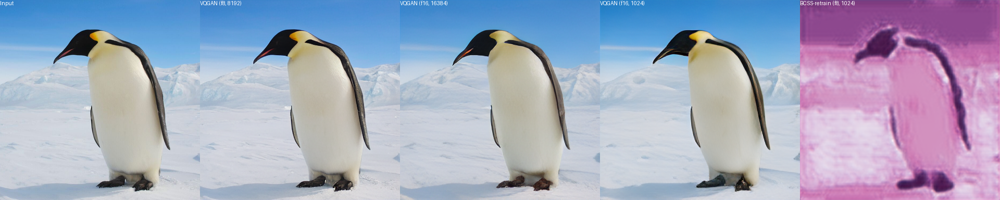

In [116]:
reconstruction_pipeline(url='https://assets.bwbx.io/images/users/iqjWHBFdfxIU/iKIWgaiJUtss/v2/1000x-1.jpg', size=384)

## Conclusion

These examples show that the use of an adversarial loss applied in a patch-wise manner does indeed help to produce reconstructions that favor *realism* over a perfect reconstruction (but may cause "deletion" of certain objects, such as the pine cone in the 4th example). Furthermore, the adversarial training enables very agressive downsampling: Given an image of size $256 \times 256$, the VQGAN produces a sequence of length $16 \cdot 16 = 256$ (vs. $32 \cdot 32 = 1024$ for DALL-E). This supports downstream tasks such as training attention-based models on the latent space, which, in their basic form, scale quadratically with sequence length. Thus, training the same transformer on top of the codes produced by the VQGAN is roughly 16 times faster than training it on top of DALL-E's first stage.

We also observe that a more realistic and faithful reconstruction can be achieved if $\vert \mathcal{Z} \vert$ is increased or the compression rate is decreased (f8-model). Note, however, that a lower latent dimensionality can also help a downstream autoregressive likelihood model (such as our transformer) to generate more globally coherent structures and descreases training cost.


One way to quantify the amount of "realism" captured by these models is to compute FID scores of reconstructed images w.r.t. the inputs (R-FIDs). The following table shows R-FIDs when reconstructing the validation split of the ImageNet dataset ($256 \times 256$ px images). Additionally, we also evaluate the perceptual similarity between inputs and reconstructions with the [LPIPS](https://richzhang.github.io/PerceptualSimilarity/) metric and structural similarity through PSNR and SSIM.


|   | VQGAN f16 (16384) |  VQGAN f16 (1024)  |  DALL-E f8 (8192)| VQGAN f8 (8192)|
|---| :---:| :---: | :---: | :---: |
| R-FID 	$\downarrow$ | 4.98 | 7.94 | 32.01 | 1.49 |
| LPIPS 	$\downarrow$ | 1.83 +/- 0.42 | 1.98 +/- 0.43 | 1.95 +/- 0.51 | 1.17 +/- 0.34 |
| PSNR 	$\uparrow$ | 19.9 +/- 3.4 | 19.4 +/- 3.3 | 22.8 +/- 2.1 | 22.2 +/- 3.8 |
| SSIM 	$\uparrow$ | 0.51 +/- 0.18 | 0.50 +/- 0.18 | 0.73 +/- 0.13 | 0.65 +/- 0.16 |



Finally, note that these models can be used in a fully convolutional fashion: For an input of size $(h, w)$, the corresponding latent representation is always $(h/2^m, w/2^m)$, with $m=4$ for the VQGANs presented here and $m=3$ for the autoencoder of DALL-E. 

input is of size: torch.Size([1, 3, 320, 320])
VQGAN --- GumbelVQ: latent shape: torch.Size([40, 40])
VQGAN --- VQModel: latent shape: torch.Size([20, 20])
VQGAN --- VQModel: latent shape: torch.Size([20, 20])
VQGAN --- VQModel: latent shape: torch.Size([40, 40])
(320, 320)
(320, 320)
(320, 320)
(320, 320)


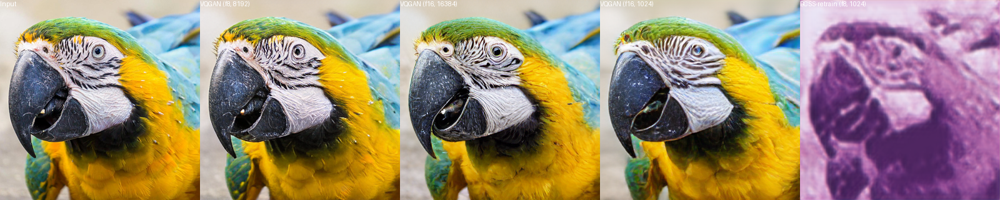

input is of size: torch.Size([1, 3, 512, 512])
VQGAN --- GumbelVQ: latent shape: torch.Size([64, 64])
VQGAN --- VQModel: latent shape: torch.Size([32, 32])
VQGAN --- VQModel: latent shape: torch.Size([32, 32])
VQGAN --- VQModel: latent shape: torch.Size([64, 64])
(512, 512)
(512, 512)
(512, 512)
(512, 512)


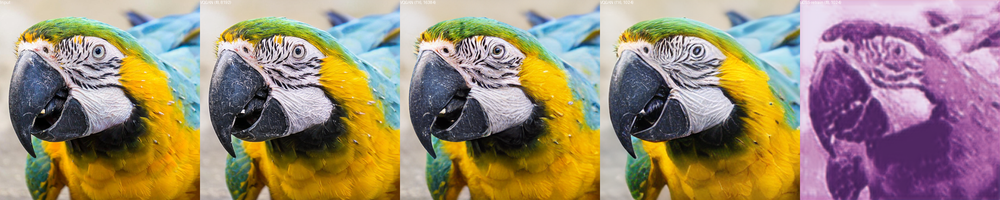

In [117]:
display(reconstruction_pipeline("https://heibox.uni-heidelberg.de/f/5cfd15de5d104d6fbce4/?dl=1", size=320))
display(reconstruction_pipeline("https://heibox.uni-heidelberg.de/f/5cfd15de5d104d6fbce4/?dl=1", size=512))